Based on: 

Steyde, G., Spairani, E., Magenes, G. et al. Fetal heart rate spectral analysis in raw signals and PRSA-derived curve: normal and pathological fetuses discrimination. Med Biol Eng Comput 62, 437–447 (2024). https://doi.org/10.1007/s11517-023-02953-5

Axel Bauer, Jan W. Kantelhardt, Armin Bunde, Petra Barthel, Raphael Schneider, Marek Malik, Georg Schmidt, Phase-rectified signal averaging detects quasi-periodicities in non-stationary data,
Physica A: Statistical Mechanics and its Applications, Volume 364, 2006, Pages 423-434,
ISSN 0378-4371, https://doi.org/10.1016/j.physa.2005.08.080.

In [1]:
PATH = '' # Where the repository was cloned
import sys
sys.path.append(PATH)

import numpy as np
import pandas as pd
import neurokit2 as nk

from prsa.utilities import fill_missing_values
from prsa.quantification import calculate_capacity_campana
from prsa.prsa import perform_rr_based_prsa
from prsa.anchor_point_identification import detect_anchors_mean_acc, detect_anchors_mean_dc
from prsa.signal_preprocessing import clean_rr_intervals_by_derivative
from prsa.anchor_point_identification import detect_anchors_from_rr_acc, detect_anchors_from_rr_dc
from prsa.visualization_tools import plot_signal, plot_signal_with_anchors, plot_segments_with_prsa_output, plot_subset_segments_with_prsa_output, plot_rr_intervals, plot_rr_intervals_with_anchors

In [2]:
data_path = "" #Path to signal

#Loading logic
data = pd.read_csv(data_path)
data.reset_index(drop=True, inplace=True)
data = fill_missing_values(data)

time, signal = data["TimeSteps"], data["Values"]

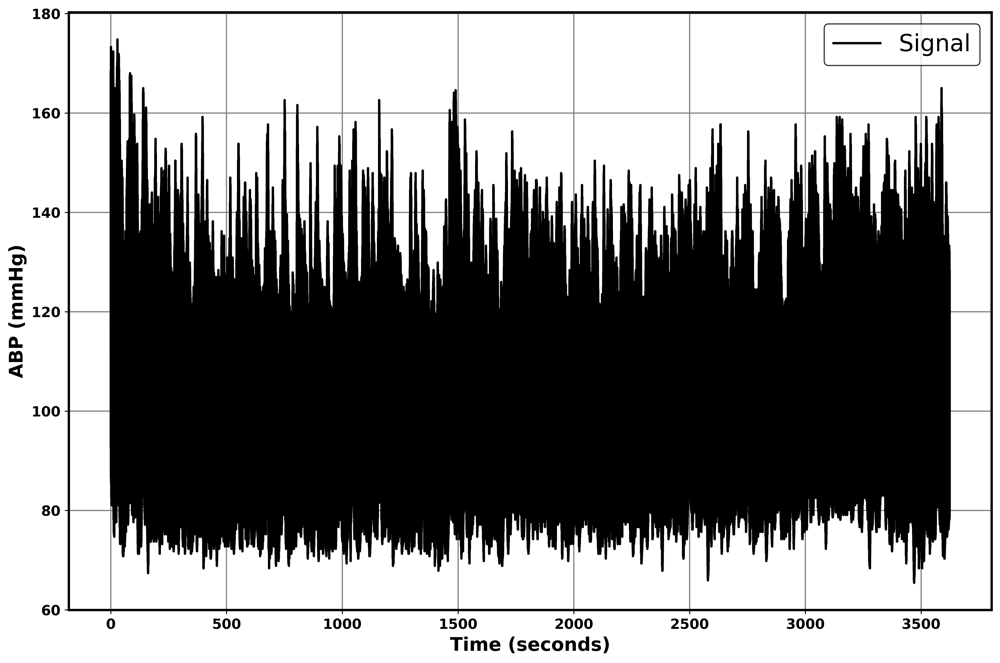

In [3]:
plot_signal(signal)

In [4]:
sampling_rate = 200

cleaned_signal = nk.ppg_clean(signal, sampling_rate=sampling_rate, method='elgendi')
peaks_info = nk.ppg_findpeaks(cleaned_signal, sampling_rate=sampling_rate, method='elgendi', mindelay=0.6)

r_peaks = peaks_info['PPG_Peaks']
rr_intervals = np.diff(r_peaks) / sampling_rate * 1000 

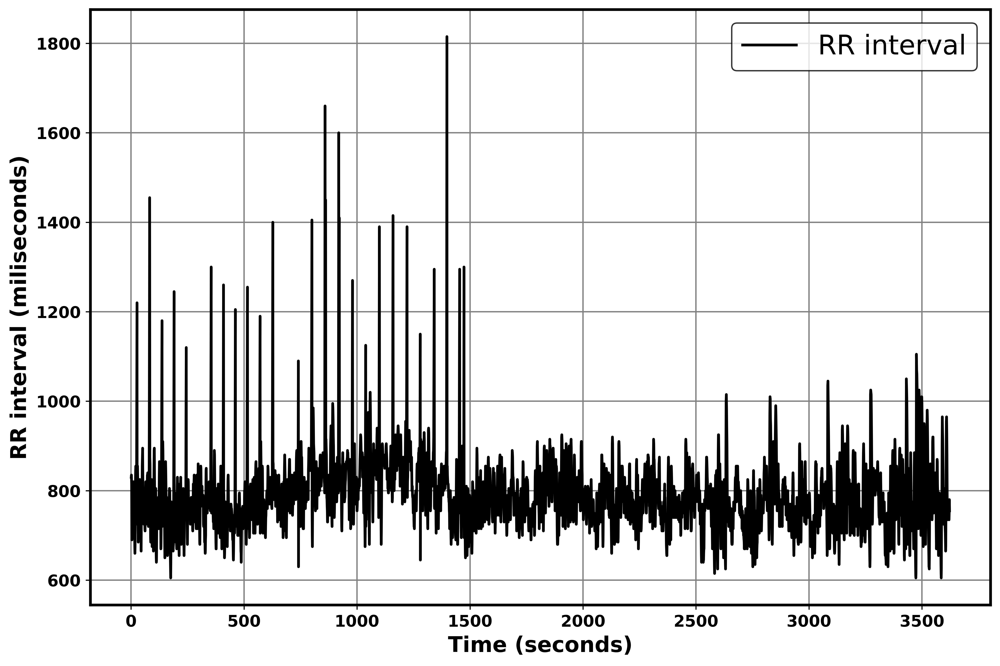

In [5]:
plot_rr_intervals(rr_intervals)

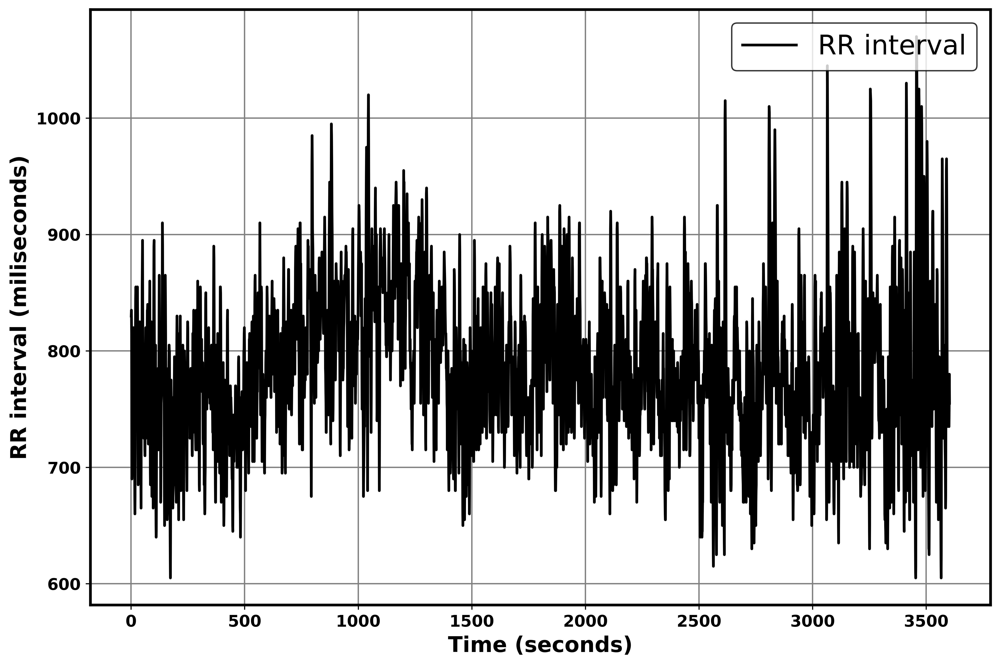

In [6]:
rr_intervals = clean_rr_intervals_by_derivative(rr_intervals)
plot_rr_intervals(rr_intervals)

In [14]:
T = 1
L = 50

idx_anchors_acc = detect_anchors_mean_acc(rr_intervals, T)
idx_anchors_dc = detect_anchors_mean_dc(rr_intervals, T)

segments_array_acc, prsa_output_acc = perform_rr_based_prsa(rr_intervals, idx_anchors_acc, L)
segments_array_dc, prsa_output_dc = perform_rr_based_prsa(rr_intervals, idx_anchors_dc, L)

In [15]:
start_time = 0
end_time = len(signal)

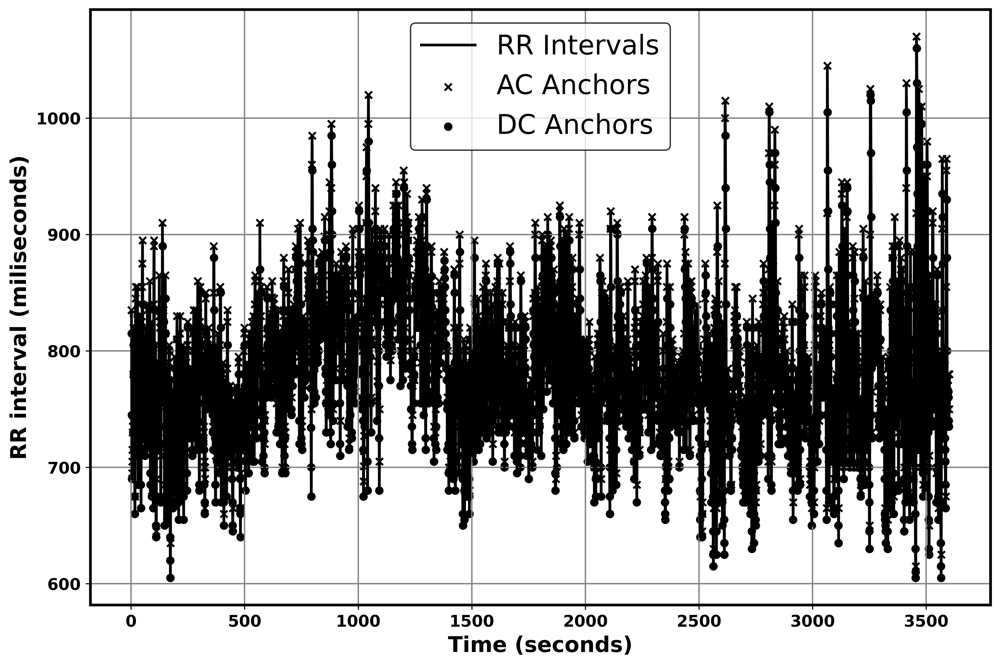

In [16]:
plot_rr_intervals_with_anchors(np.cumsum(rr_intervals), rr_intervals, idx_anchors_acc, 
                               idx_anchors_dc, start_time, end_time)

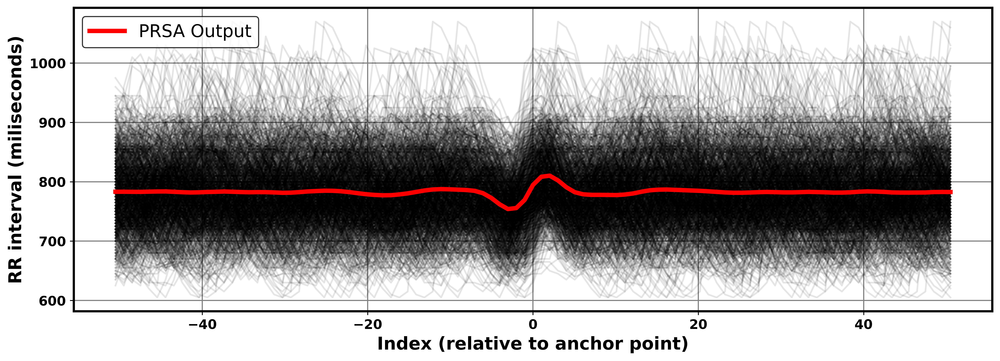

In [17]:
plot_segments_with_prsa_output(segments_array_acc, prsa_output_acc, idx_anchors_acc, True)

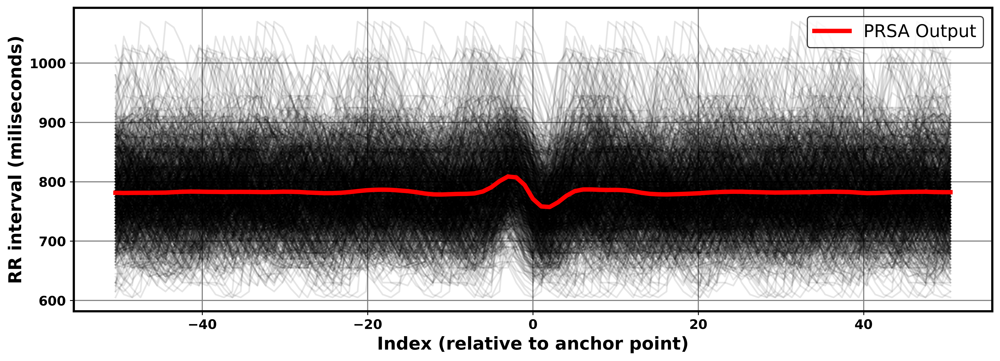

In [18]:
plot_segments_with_prsa_output(segments_array_dc, prsa_output_dc, idx_anchors_dc, True)

In [19]:
quantified_prsa_ac = calculate_capacity_campana(prsa_output_acc)
quantified_prsa_dc = calculate_capacity_campana(prsa_output_dc)

In [20]:
print("AC:", quantified_prsa_ac, "DC:", quantified_prsa_dc)

AC: 0.21337500000004184 DC: -0.5878378378378386
